In [4]:
import matplotlib.cm as cm
import matplotlib.colors as colors
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
import folium
from geopy.geocoders import Nominatim
import json # library to handle JSON files
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import cv2
import matplotlib.pyplot as plt

In [5]:
df = pd.read_csv('Book1.csv')
df.head()

,Ward,Population,Density
0,Chiyoda,59441,5100
1,Chuo,147620,14460
2,Minato,248071,12180
3,Shinjuku,339211,18620
4,Bunkyo,223389,19790


In [6]:
districts = pd.read_csv('districts.csv')
districts.head()

,District,Ward
0,Nagatacho,Chiyoda
1,Kasumigaseki,Chiyoda
2,Otemachi,Chiyoda
3,Marunouchi,Chiyoda
4,Akihabara,Chiyoda


In [7]:
address = 'Tokyo, Japan'

geolocator = Nominatim(user_agent="Tok_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Tokyo are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Tokyo are 35.6828387, 139.7594549.


In [9]:
import plotly.express as px

fig = px.choropleth(df, geojson=tokyo_geo, color="Density",
                    locations="Ward", featureidkey="properties.ward_en",
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [10]:
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="Tokyo_explorer")
latitude = []
longitude = []
for i in districts['District']:
    try:
        location = geolocator.geocode(i)
        latitude.append(location.latitude)
        longitude.append(location.longitude)
    except: 
        latitude.append(np.nan)
        longitude.append(np.nan)


In [11]:
latitude = pd.DataFrame(latitude)
longitude = pd.DataFrame(longitude)

In [12]:
districts['Longitude'] = longitude
districts['Latitude'] = latitude
districts.head()

,District,Ward,Longitude,Latitude
0,Nagatacho,Chiyoda,139.743469,35.675618
1,Kasumigaseki,Chiyoda,139.750972,35.674054
2,Otemachi,Chiyoda,139.763616,35.686757
3,Marunouchi,Chiyoda,139.765222,35.680656
4,Akihabara,Chiyoda,139.771250,35.699736


In [13]:
districts.to_csv("districtsLatLong.csv")

In [14]:
districts = districts.dropna()

In [15]:
map_tokyo = folium.Map(location=[35.6828387, 139.7594549], zoom_start=8, tiles = "StamenToner")

# add markers to map
for lat, lng, borough, neighborhood in zip(districts['Latitude'], districts['Longitude'], districts['Ward'], districts['District']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_tokyo)  
    
map_tokyo

In [16]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Scattergeo(
        lon = districts['Longitude'],
        lat = districts['Latitude'],
        text = districts['District'],
        mode = 'markers',
        ))

fig.update_layout(
        geo_scope='world',
    )
fig.show()

In [17]:
tokDistricts = pd.read_csv('districtsLatLong1.csv')
fig = go.Figure(data=go.Scattergeo(
        lon = tokDistricts['Longitude'],
        lat = tokDistricts['Latitude'],
        text = tokDistricts['District'],
        mode = 'markers',
        ))

fig.update_layout(
        geo_scope='world',
    )
fig.show()

In [18]:
map_tokyo = folium.Map(location=[35.6828387, 139.7594549], zoom_start=11, tiles='https://tiles.stadiamaps.com/tiles/outdoors/{z}/{x}/{y}{r}.png', attr='https://tiles.stadiamaps.com/tiles/outdoors/{z}/{x}/{y}{r}.png')

# add markers to map
for lat, lng, borough, neighborhood in zip(tokDistricts['Latitude'], tokDistricts['Longitude'], tokDistricts['Ward'], tokDistricts['District']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_tokyo)  
    
map_tokyo

In [19]:
map_tokyo = folium.Map(location=[35.6828387, 139.7594549], zoom_start=11, tiles='https://tiles.stadiamaps.com/tiles/outdoors/{z}/{x}/{y}{r}.png', attr='https://tiles.stadiamaps.com/tiles/outdoors/{z}/{x}/{y}{r}.png')

map_tokyo.choropleth(
    geo_data=tokyo_geo,
    data=df,
    columns=['Ward', 'Density'],
    key_on='feature.properties.ward_en',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Tokyo Ward Density'
)

# add markers to map
for lat, lng, borough, neighborhood in zip(tokDistricts['Latitude'], tokDistricts['Longitude'], tokDistricts['Ward'], tokDistricts['District']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_tokyo)  
# display map
map_tokyo

In [29]:
CLIENT_ID = 'XVXL0MZ5JBK5NMHWAK3PZIVCOFWJRNPZP5BW2HYDMPT5PKCV' # your Foursquare ID
CLIENT_SECRET = 'UKMWMS43JYYLGJKW4LQQFI5STD2EGGHXK0SDQT2MM5FDG4CI' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XVXL0MZ5JBK5NMHWAK3PZIVCOFWJRNPZP5BW2HYDMPT5PKCV
CLIENT_SECRET:UKMWMS43JYYLGJKW4LQQFI5STD2EGGHXK0SDQT2MM5FDG4CI


Let's define some functions.

In [30]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [31]:
def getNearbyVenues(names, latitudes, longitudes, radius=100, LIMIT=10):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            'XVXL0MZ5JBK5NMHWAK3PZIVCOFWJRNPZP5BW2HYDMPT5PKCV', 
            'UKMWMS43JYYLGJKW4LQQFI5STD2EGGHXK0SDQT2MM5FDG4CI', 
            '20180605', 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

Just use the names of the districts and put them in a new dataframe.

In [32]:
tokyo_venues = getNearbyVenues(names = tokDistricts['District'],
                                   latitudes = tokDistricts['Latitude'],
                                   longitudes = tokDistricts['Longitude'], 
                            
                                  )

Akabane
Akihabara
Aobadai
Aomi
Aoto
Aoyama
Arakawa
Ariake
Asagaya
Asakusa
Ayase
Azabu
Daikanyama
Den-en-chofu
Ebisu
Etchujima
Fukagawa
Ginza
Gotanda
Hakusan
Hamamatsucho
Haneda
Harajuku
Hatanodai
Hatchobori
Hikarigaoka
Hiroo
Hongo
Ichigaya
Iidabashi
Ikebukuro
Itabashi
Jiyugeoka
Kachidoki
Kagurazaka
Kamata
Kameari
Kameido
Kanda
Karasuyama
Kasai
Kasumigaseki
Kayabacho
Kiba
Kinshicho
Kinuta
Kitasenju
Kiyosumi
Koenji
Koiwa
Komaba
Komagome
Machiya
Marunouchi
Meguro
Minamisenju
Mita
Monzennakacho
Morishita
Nagatacho
Nakameguro
Nakano
Nerima
Nihonbashi
Nippori
Odaiba
Ogikubo
Oimachi
Oizumi
Oji
Okubo
Omori
Osaki
Otemachi
Roppongi
Ryogoku
Sendagaya
Senkawa
Setagaya
Shibamata
Shibuya
Shimokitazawa
Shinagawa
Shinbashi
Shinjuku
Shinkawa
Shirakawa
Sugamo
Sunamachi
Tabata
Takadanobaba
Takashimadaira
Takenotsuka
Tamagawa
Tateishi
Tennozu
Toranomon
Toyocho
Tsukiji
Tsukishima
Tsukuda
Ueno
Yayoi
Yotsuya
Yoyogi
Yurakucho


In [33]:
print(tokyo_venues.shape)
tokyo_venues.head()

(661, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Akabane,35.778139,139.7208,Maruyoshi (まるよし),35.778424,139.721332,Sake Bar
1,Akabane,35.778139,139.7208,昔ながらの喫茶店 友路有,35.778208,139.721213,Tea Room
2,Akabane,35.778139,139.7208,Felts (LE BIAN (ex. Felts)),35.777572,139.721039,Bakery
3,Akabane,35.778139,139.7208,Beans Akabane (ビーンズ赤羽),35.777649,139.721294,Shopping Mall
4,Akabane,35.778139,139.7208,Ito (自家製麺 伊藤),35.778266,139.721495,Ramen Restaurant


In [34]:
print('There are {} uniques categories.'.format(len(tokyo_venues['Venue Category'].unique())))

There are 146 uniques categories.


In [35]:
# one hot encoding
tokyo_onehot = pd.get_dummies(tokyo_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
tokyo_onehot['Neighborhood'] = tokyo_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [tokyo_onehot.columns[-1]] + list(tokyo_onehot.columns[:-1])
tokyo_onehot = tokyo_onehot[fixed_columns]

tokyo_onehot.head()

,Neighborhood,ATM,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Australian Restaurant,BBQ Joint,...,Unagi Restaurant,Used Bookstore,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wagashi Place,Whisky Bar,Wine Bar,Wine Shop,Yakitori Restaurant,Yoshoku Restaurant
0,Akabane,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Akabane,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Akabane,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Akabane,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Akabane,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [36]:
tokyo_grouped = tokyo_onehot.groupby('Neighborhood').mean().reset_index()
tokyo_grouped

,Neighborhood,ATM,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Australian Restaurant,BBQ Joint,...,Unagi Restaurant,Used Bookstore,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wagashi Place,Whisky Bar,Wine Bar,Wine Shop,Yakitori Restaurant,Yoshoku Restaurant
0,Akabane,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Akihabara,0.0,0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Aobadai,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Aomi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Aoto,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Ueno,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
92,Yayoi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
93,Yotsuya,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
94,Yoyogi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [37]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [39]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = tokyo_grouped['Neighborhood']

for ind in np.arange(tokyo_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(tokyo_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Akabane,Sake Bar,Dumpling Restaurant,Tea Room,Clothing Store,Soba Restaurant,Coffee Shop,Shopping Mall,Bakery,Ramen Restaurant,Electronics Store
1,Akihabara,Café,Electronics Store,Sake Bar,Arcade,Ramen Restaurant,Comic Shop,Hobby Shop,Fishing Spot,Fried Chicken Joint,French Restaurant
2,Aobadai,Park,Diner,Gift Shop,Furniture / Home Store,Fried Chicken Joint,French Restaurant,Food Truck,Flower Shop,Fishing Spot,Yoshoku Restaurant
3,Aomi,Coffee Shop,Shopping Mall,Fast Food Restaurant,Playground,Plaza,Farmers Market,French Restaurant,Food Truck,Flower Shop,Fishing Spot
4,Aoto,Convenience Store,Sake Bar,Chinese Restaurant,Fried Chicken Joint,Udon Restaurant,Donburi Restaurant,Italian Restaurant,Sandwich Place,Donut Shop,Drugstore


In [40]:
kclusters = 5

tokyo_grouped_clustering = tokyo_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(tokyo_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([0, 0, 1, 0, 3, 0, 3, 3, 0, 0])

In [44]:
# add clustering labels
kmeans.labels_ = pd.DataFrame(kmeans.labels_)
neighborhoods_venues_sorted1 = pd.concat([neighborhoods_venues_sorted, kmeans.labels_], axis=1)
neighborhoods_venues_sorted1.rename(columns={0: "Clusters", 'Neighborhood': 'District'}, inplace = True)

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
tokyo_merged = pd.merge(tokDistricts,neighborhoods_venues_sorted1,on='District')
tokyo_merged.head() # check the last columns!

,wa,District,Ward,Longitude,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Clusters
0,85,Akabane,Kita,139.720800,35.778139,Sake Bar,Dumpling Restaurant,Tea Room,Clothing Store,Soba Restaurant,Coffee Shop,Shopping Mall,Bakery,Ramen Restaurant,Electronics Store,0
1,4,Akihabara,Chiyoda,139.771250,35.699736,Café,Electronics Store,Sake Bar,Arcade,Ramen Restaurant,Comic Shop,Hobby Shop,Fishing Spot,Fried Chicken Joint,French Restaurant,0
2,60,Aobadai,Meguro,139.694300,35.650900,Park,Diner,Gift Shop,Furniture / Home Store,Fried Chicken Joint,French Restaurant,Food Truck,Flower Shop,Fishing Spot,Yoshoku Restaurant,1
3,49,Aomi,Koto,139.781202,35.624779,Coffee Shop,Shopping Mall,Fast Food Restaurant,Playground,Plaza,Farmers Market,French Restaurant,Food Truck,Flower Shop,Fishing Spot,0
4,101,Aoto,Katsushika,139.856173,35.745697,Convenience Store,Sake Bar,Chinese Restaurant,Fried Chicken Joint,Udon Restaurant,Donburi Restaurant,Italian Restaurant,Sandwich Place,Donut Shop,Drugstore,3


In [45]:
# create map
map_clusters = folium.Map(location=[35.6828387, 139.7594549], zoom_start=10)

map_clusters.choropleth(
    geo_data=tokyo_geo,
    data=df,
    columns=['Ward', 'Density'],
    key_on='feature.properties.ward_en',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Tokyo Ward Density'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(tokyo_merged['Latitude'], tokyo_merged['Longitude'], tokyo_merged['District'], tokyo_merged['Clusters']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    #cluster = int(cluster)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

It looks like there is only one blue cluster, so maybe the cluster number is incorrect.

In [52]:
kclusters = 4

tokyo_grouped_clustering = tokyo_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(tokyo_grouped_clustering)

# add clustering labels
kmeans.labels_ = pd.DataFrame(kmeans.labels_)
neighborhoods_venues_sorted1 = pd.concat([neighborhoods_venues_sorted, kmeans.labels_], axis=1)
neighborhoods_venues_sorted1.rename(columns={0: "Clusters", 'Neighborhood': 'District'}, inplace = True)

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
tokyo_merged = pd.merge(tokDistricts,neighborhoods_venues_sorted1,on='District')
tokyo_merged.head() # check the last columns!

# create map
map_clusters = folium.Map(location=[35.6828387, 139.7594549], zoom_start=10)

map_clusters.choropleth(
    geo_data=tokyo_geo,
    data=df,
    columns=['Ward', 'Density'],
    key_on='feature.properties.ward_en',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Tokyo Ward Density'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(tokyo_merged['Latitude'], tokyo_merged['Longitude'], tokyo_merged['District'], tokyo_merged['Clusters']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    #cluster = int(cluster)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters


In [53]:
tokyo_merged.head()

,wa,District,Ward,Longitude,Latitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Clusters
0,85,Akabane,Kita,139.720800,35.778139,Sake Bar,Dumpling Restaurant,Tea Room,Clothing Store,Soba Restaurant,Coffee Shop,Shopping Mall,Bakery,Ramen Restaurant,Electronics Store,2
1,4,Akihabara,Chiyoda,139.771250,35.699736,Café,Electronics Store,Sake Bar,Arcade,Ramen Restaurant,Comic Shop,Hobby Shop,Fishing Spot,Fried Chicken Joint,French Restaurant,0
2,60,Aobadai,Meguro,139.694300,35.650900,Park,Diner,Gift Shop,Furniture / Home Store,Fried Chicken Joint,French Restaurant,Food Truck,Flower Shop,Fishing Spot,Yoshoku Restaurant,1
3,49,Aomi,Koto,139.781202,35.624779,Coffee Shop,Shopping Mall,Fast Food Restaurant,Playground,Plaza,Farmers Market,French Restaurant,Food Truck,Flower Shop,Fishing Spot,0
4,101,Aoto,Katsushika,139.856173,35.745697,Convenience Store,Sake Bar,Chinese Restaurant,Fried Chicken Joint,Udon Restaurant,Donburi Restaurant,Italian Restaurant,Sandwich Place,Donut Shop,Drugstore,3


In [137]:
clus0 = tokyo_merged.loc[tokyo_merged['Clusters'] == 0]
clus1 = tokyo_merged.loc[tokyo_merged['Clusters'] == 1]
clus2 = tokyo_merged.loc[tokyo_merged['Clusters'] == 2]
clus3 = tokyo_merged.loc[tokyo_merged['Clusters'] == 3]

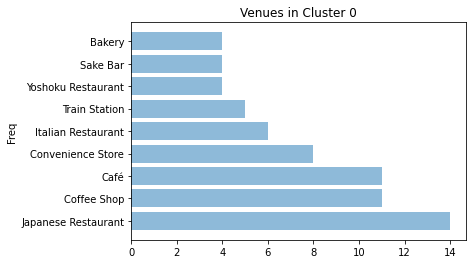

In [133]:
lis = (clus0.iloc[:,5:8])
lis['ID'] = np.arange(0,59,1)
output_df = lis.melt(id_vars=["ID"])
#output_df
value0 = output_df.iloc[:,2].value_counts()
value0 = pd.DataFrame(value0)
value0 = value0.loc[value0["value"] > 3]
value0.reset_index(level=0, inplace=True)
plt.barh(value0["index"], value0["value"], align='center', alpha=0.5)
plt.ylabel('Freq')
plt.title('Venues in Cluster 0')

plt.show()

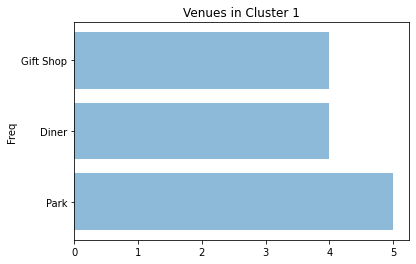

In [134]:
lis = (clus1.iloc[:,5:8])
lis['ID'] = np.arange(0,len(lis),1)
output_df = lis.melt(id_vars=["ID"])
#output_df
value0 = output_df.iloc[:,2].value_counts()
value0 = pd.DataFrame(value0)
value0 = value0.loc[value0["value"] > 3]
value0.reset_index(level=0, inplace=True)
plt.barh(value0["index"], value0["value"], align='center', alpha=0.5)
plt.ylabel('Freq')
plt.title('Venues in Cluster 1')

plt.show()

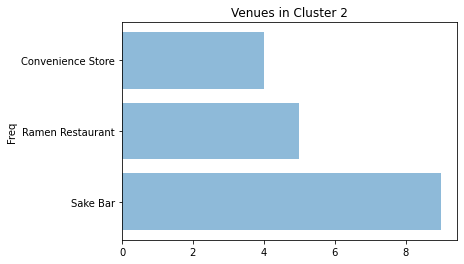

In [135]:
lis = (clus2.iloc[:,5:8])
lis['ID'] = np.arange(0,len(lis),1)
output_df = lis.melt(id_vars=["ID"])
#output_df
value0 = output_df.iloc[:,2].value_counts()
value0 = pd.DataFrame(value0)
value0 = value0.loc[value0["value"] > 3]
value0.reset_index(level=0, inplace=True)
plt.barh(value0["index"], value0["value"], align='center', alpha=0.5)
plt.ylabel('Freq')
plt.title('Venues in Cluster 2')

plt.show()

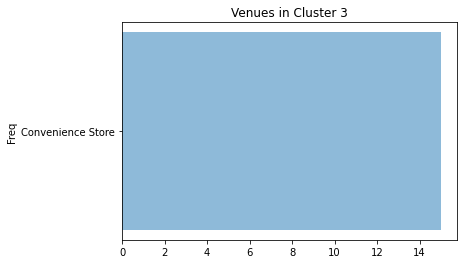

In [136]:
lis = (clus3.iloc[:,5:8])
lis['ID'] = np.arange(0,len(lis),1)
output_df = lis.melt(id_vars=["ID"])
#output_df
value0 = output_df.iloc[:,2].value_counts()
value0 = pd.DataFrame(value0)
value0 = value0.loc[value0["value"] > 3]
value0.reset_index(level=0, inplace=True)
plt.barh(value0["index"], value0["value"], align='center', alpha=0.5)
plt.ylabel('Freq')
plt.title('Venues in Cluster 3')

plt.show()

So it looks like cluster 0 has the most interesting venues.